In [3]:
import tensorflow as tf
import sys

sys.path.append('../')

from src.Objective import Objective
from src.Parameterization import Parameterization, get_fft_scale, fft_to_rgb
from src.Transformation import *
from src.Regularizer import *
from src.Optimizer import *
from src.Miscellaneous import *
from src.Attribution import *
from src.Wrapper import *

print(tf.__version__)
print(tf.config.list_physical_devices('GPU'))

2.10.0
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


# Model selection

In [9]:
# Model names: https://keras.io/api/applications/

model = Wrapper(model = 'InceptionV3')

print(model.layers())

['input_2', 'conv2d', 'batch_normalization', 'activation', 'conv2d_1', 'batch_normalization_1', 'activation_1', 'conv2d_2', 'batch_normalization_2', 'activation_2', 'max_pooling2d', 'conv2d_3', 'batch_normalization_3', 'activation_3', 'conv2d_4', 'batch_normalization_4', 'activation_4', 'max_pooling2d_1', 'conv2d_8', 'batch_normalization_8', 'activation_8', 'conv2d_6', 'conv2d_9', 'batch_normalization_6', 'batch_normalization_9', 'activation_6', 'activation_9', 'average_pooling2d', 'conv2d_5', 'conv2d_7', 'conv2d_10', 'conv2d_11', 'batch_normalization_5', 'batch_normalization_7', 'batch_normalization_10', 'batch_normalization_11', 'activation_5', 'activation_7', 'activation_10', 'activation_11', 'mixed0', 'conv2d_15', 'batch_normalization_15', 'activation_15', 'conv2d_13', 'conv2d_16', 'batch_normalization_13', 'batch_normalization_16', 'activation_13', 'activation_16', 'average_pooling2d_1', 'conv2d_12', 'conv2d_14', 'conv2d_17', 'conv2d_18', 'batch_normalization_12', 'batch_normaliza

# Standard transformation set

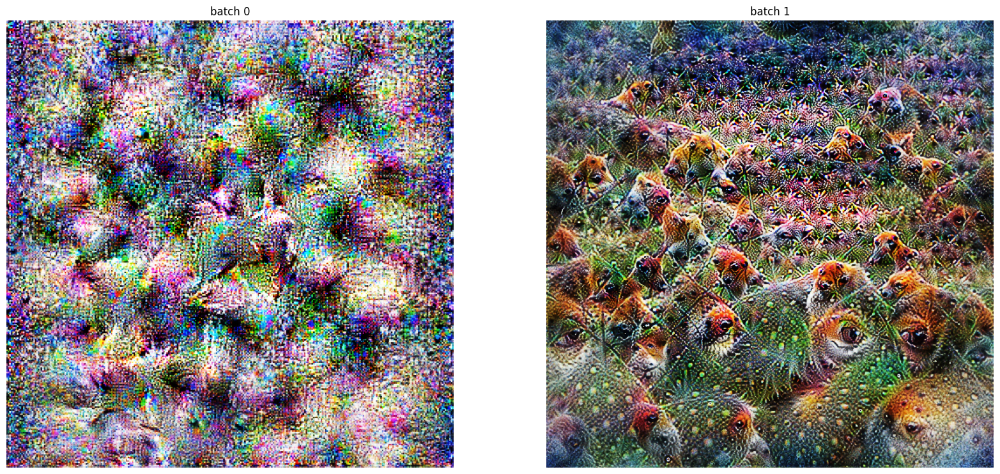

In [10]:
# Layer name
layer = 'mixed5'

unit = int(512 / 16)

# standard transformation set for optimization nice results
standard =  [padding(unit * 4),
             jitter(unit * 2, seed = 0),
             jitter(unit * 2, seed = 0),
             jitter(unit * 4, seed = 0),
             jitter(unit * 4, seed = 0),
             jitter(unit * 4, seed = 0),
             scale((0.92, 0.96), seed = 0),
             blur_T(sigma_range = (1.0, 1.1)),
             jitter(unit, seed = 0),
             jitter(unit, seed = 0),
             flip(seed = 0)]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Original output vs Transformations output
for transformation in [None] + [standard]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = [] if transformation is None else transformation,
                      verbose = False)[0])
    
plot_all(images)

# Box filter

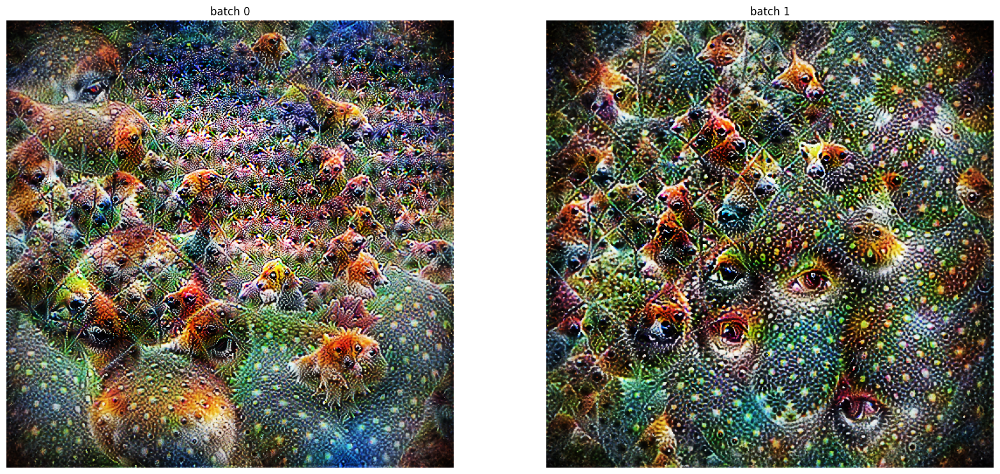

In [15]:
# Layer name
layer = 'mixed5'

kernel_size = 3

transformation =  [apply_kernel(kernel_size, 'BOX')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Box filter with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Laplace for edge detection

### Simple laplace

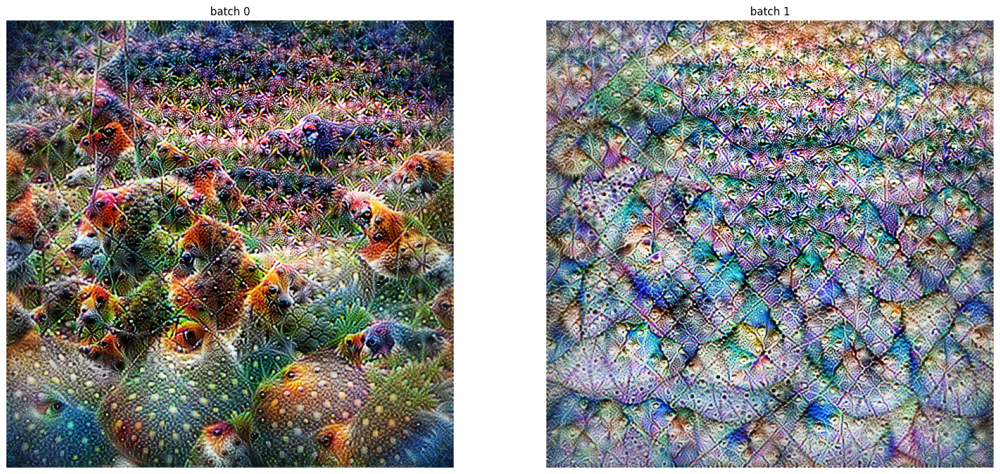

In [16]:
# Layer name
layer = 'mixed5'

kernel_size = 1

transformation =  [apply_kernel(kernel_size, 'SIMPLE-LAPLACE')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Simple laplace with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

### Hard laplace

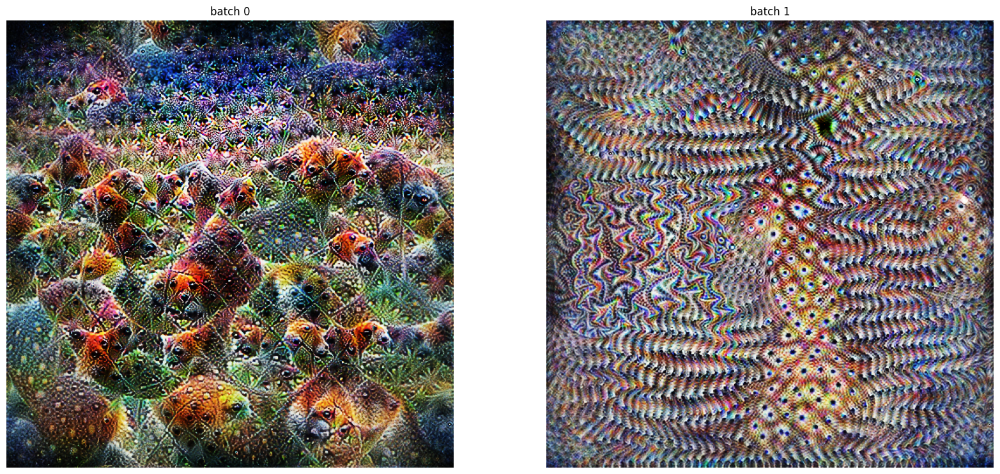

In [18]:
# Layer name
layer = 'mixed5'

kernel_size = 3

transformation =  [apply_kernel(kernel_size, 'HARD-LAPLACE')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Hard laplace filter with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Sharpness filter

### Normal sharpness

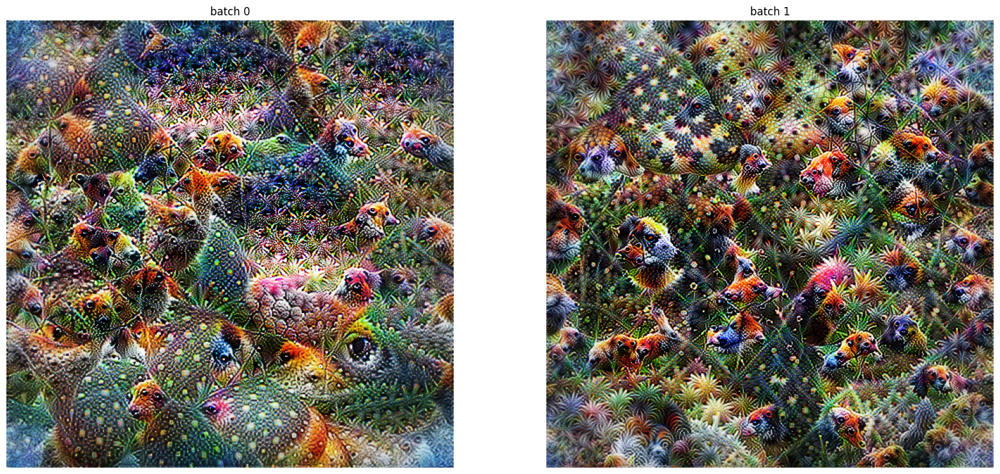

In [19]:
# Layer name
layer = 'mixed5'

kernel_size = 3

transformation =  [apply_kernel(kernel_size, 'SHARPNESS')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Normal sharpness with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

### Hard sharpness

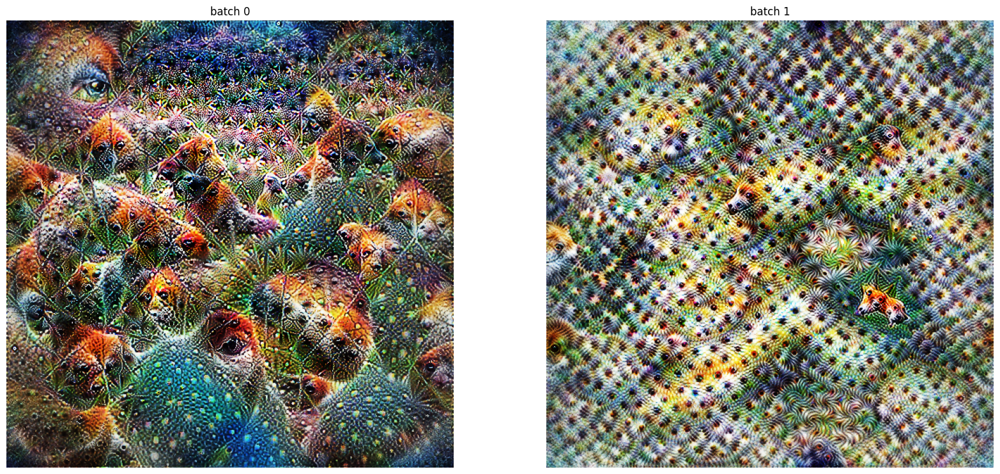

In [20]:
# Layer name
layer = 'mixed5'

kernel_size = 3

transformation =  [apply_kernel(kernel_size, 'HARD-SHARPNESS')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Hard sharpness with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Blur

### Gaussian Blur

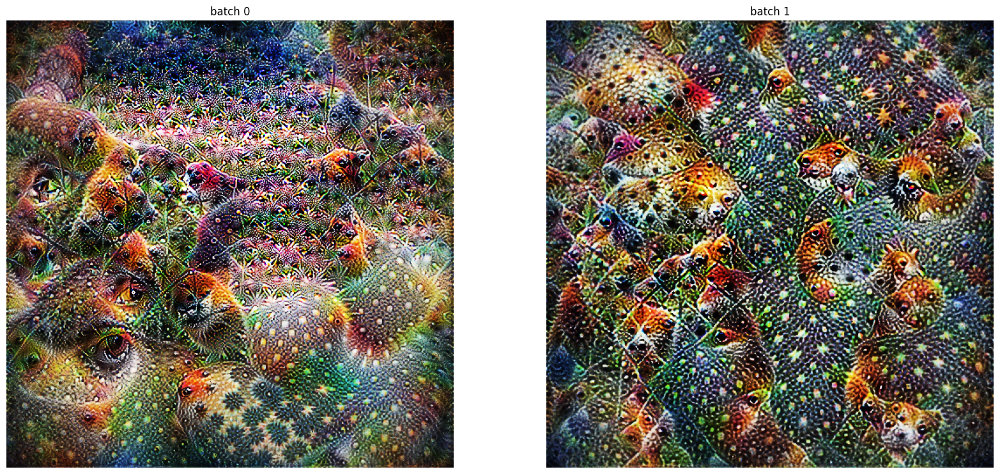

In [21]:
# Layer name
layer = 'mixed5'

kernel_size = 5

transformation =  [apply_kernel(kernel_size, 'GAUSSIAN-BLUR')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Gaussian blur with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

### Motion Blur

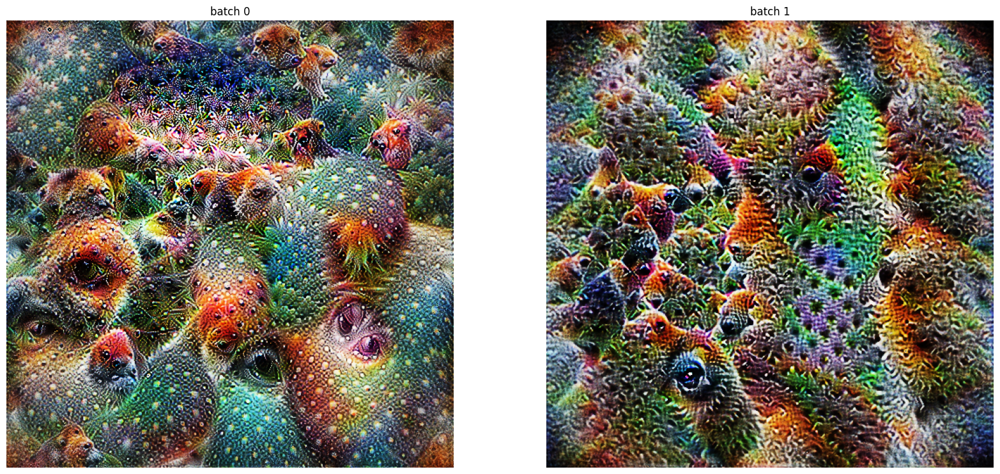

In [23]:
# Layer name
layer = 'mixed5'

kernel_size = 5

transformation =  [apply_kernel(kernel_size, 'MOTION-BLUR')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Motion blur with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Mean and median filter

### Mean

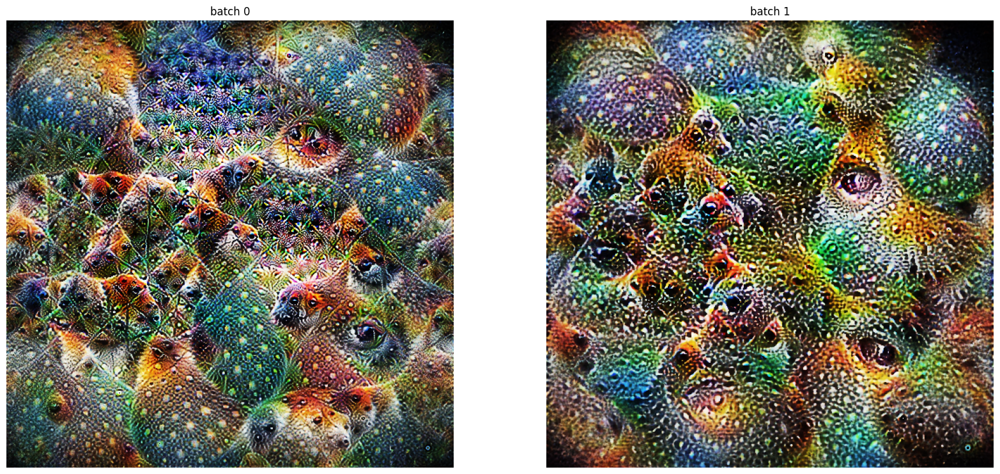

In [27]:
# Layer name
layer = 'mixed5'

kernel_size = 5

transformation =  [mean(kernel_size)]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Mean filter with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

### Median

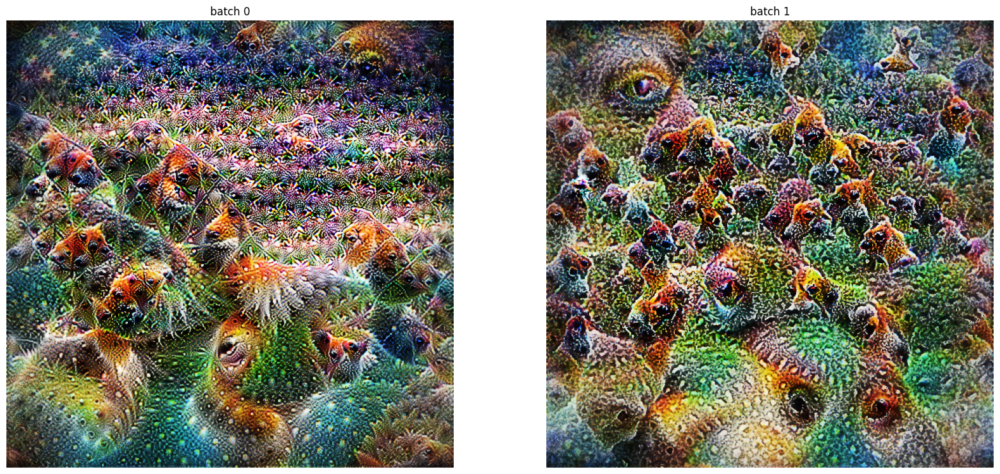

In [28]:
# Layer name
layer = 'mixed5'

kernel_size = 5

transformation =  [median(kernel_size)]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Median filter with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Deconvolution

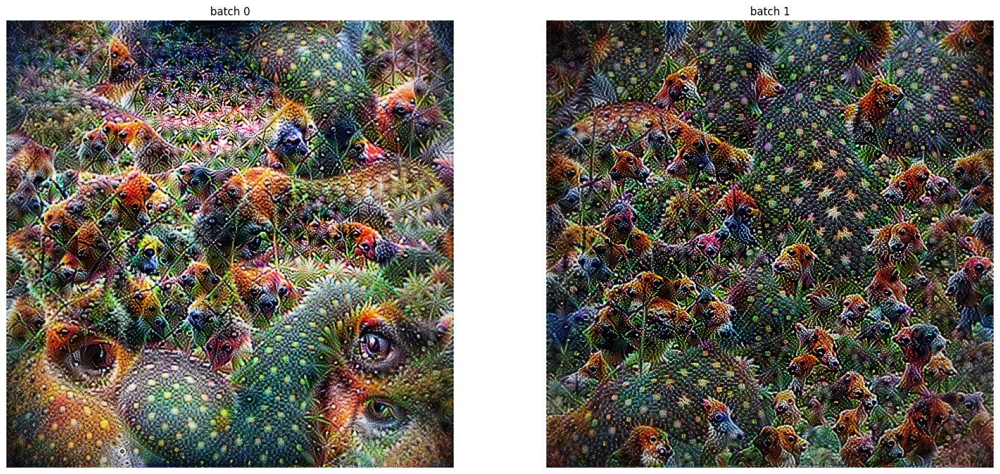

In [31]:
# Layer name
layer = 'mixed5'

kernel_size = 3

transformation =  [deconvolution(512, size = kernel_size)]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Median filter with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)